In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2
from PIL import Image

import random
random.seed = 69

In [2]:
input_size = 512
root_dir = "C:/Users/ArrunPersonal/Codes/MedicalImageSegmentation/EndoVis2018"
train_dir = os.path.join(root_dir,"train")
val_dir = os.path.join(root_dir,"val_new")

In [3]:
# defining other metrics:
def psnr(y_true,y_pred):
    return tf.image.psnr(y_true,y_pred,1.0)
def ssim(y_true,y_pred):
    return tf.image.ssim(y_true,y_pred,1.0)

In [4]:
from tensorflow.keras.utils import to_categorical

In [5]:
def get_randomized_filenames(directory_path):
    filenames = os.listdir(directory_path)
    random.shuffle(filenames)
    return filenames

# Example usage:
directory_path = train_dir+"/images"
randomized_filenames = get_randomized_filenames(directory_path)

split_index = len(randomized_filenames)*9//10
train_filenames, val_filenames = randomized_filenames[:split_index],randomized_filenames[split_index:]

In [6]:
# load and prepare training images
def load_images(split_type, filenames, batch_size,batch_number):
    in_img = []
    if(split_type == "train"):
        img_dir = train_dir+"/images"
        os.chdir(img_dir)
        
    elif(split_type == "val_new"):
        img_dir = val_dir+"/images"
        os.chdir(img_dir)
        
    for i in filenames[batch_size*batch_number:batch_size*(batch_number+1)]:
        if(i.endswith('.png')):
            in_img.append(cv2.resize(cv2.imread(i),(input_size,input_size))/255)
            
    return np.array(in_img, dtype='float32')

In [7]:
# load and prepare training images
def load_segmasks(split_type,filenames,batch_size,batch_number):
    segmasks = []
    
    if(split_type == "train"):
        segmap_img_dir = train_dir+"/annotations"
        os.chdir(segmap_img_dir)
    elif(split_type == "val_new"):
        segmap_img_dir = val_dir+"/annotations"
        os.chdir(segmap_img_dir)
        
    for i in filenames[batch_size*batch_number:batch_size*(batch_number+1)]:
        if(i.endswith('.png')):
            segmasks.append(cv2.resize(cv2.imread(i,cv2.IMREAD_GRAYSCALE),(input_size,input_size)))
    
    return np.array(to_categorical(segmasks,num_classes = 8), dtype='float32')

## Tensorflow Imports and Model Definition

In [8]:
#from keras.optimizers import Adam
#from keras.initializers import RandomNormal
import tensorflow as tf
from keras.models import *
from keras.layers import *
import gc

In [9]:
def encoder_block(input_features,num_filters,layer,filter_size=[3,5,7]):

    conv1_1 = Conv2D(num_filters,filter_size[0], padding = 'same',activation = 'relu', dtype='float32',name = f'conv-e-{layer}_1_1')(input_features)
    conv1_2 = Conv2D(num_filters,filter_size[1], padding = 'same',activation = 'relu', dtype='float32',name = f'conv-e-{layer}_1_2')(input_features)
    conv1_3 = Conv2D(num_filters,filter_size[2], padding = 'same',activation = 'relu', dtype='float32',name = f'conv-e-{layer}_1_3')(input_features)

    concat_12 = Concatenate(dtype='float32',name = f'conc-e-{layer}_12')([conv1_1,conv1_2])
    concat_13 = Concatenate(dtype='float32',name = f'conc-e-{layer}_23')([conv1_2,conv1_3])
    concat_23 = Concatenate(dtype='float32',name = f'conv-e-{layer}_13')([conv1_1,conv1_3])

    conv2_1 = Conv2D(num_filters,3, padding = 'same',activation = 'relu', dtype='float32',name = f'conv-e-{layer}_2_1')(concat_12)
    conv2_2 = Conv2D(num_filters,3, padding = 'same',activation = 'relu', dtype='float32',name = f'conv-e-{layer}_2_2')(concat_23)
    conv2_3 = Conv2D(num_filters,3, padding = 'same',activation = 'relu', dtype='float32',name = f'conv-e-{layer}_2_3')(concat_13)

    concat_123 = Concatenate(dtype='float32',name = f'conc-e-{layer}_123')([conv2_1,conv2_2,conv2_3])
    conv_fin = Conv2D(num_filters,3, padding = 'same',activation = 'relu', dtype='float32',name = f'conv_fin-e-{layer}_123')(concat_123)
    maxpool_fin = MaxPool2D(2, dtype='float32',name = f'maxpool_fin-{layer}')(conv_fin)
    return maxpool_fin

In [10]:
def decoder_block(input_layer,skip_connection, num_filters,layer,filter_size=[3,5,7]):
    convt1_1 = Conv2DTranspose(num_filters, filter_size[0], padding = 'same',activation = 'relu', dtype='float32',name = f'convt-d-{layer}_1_1')(input_layer)
    convt1_2 = Conv2DTranspose(num_filters, filter_size[1], padding = 'same',activation = 'relu', dtype='float32',name = f'convt-d-{layer}_1_2')(input_layer)
    convt1_3 = Conv2DTranspose(num_filters, filter_size[2], padding = 'same',activation = 'relu', dtype='float32',name = f'convt-d-{layer}_1_3')(input_layer)

    concat_12 = Concatenate(dtype='float32',name = f'conc-d-{layer}_12')([convt1_1,convt1_2])
    concat_13 = Concatenate(dtype='float32',name = f'conc-d-{layer}_23')([convt1_2,convt1_3])
    concat_23 = Concatenate(dtype='float32',name = f'conc-d-{layer}_13')([convt1_1,convt1_3])

    conv2_1 = Conv2D(num_filters,3, padding = 'same',activation = 'relu', dtype='float32',name = f'conv-d-{layer}_2_1')(concat_12)
    conv2_2 = Conv2D(num_filters,3, padding = 'same',activation = 'relu', dtype='float32',name = f'conv-d-{layer}_2_2')(concat_23)
    conv2_3 = Conv2D(num_filters,3, padding = 'same',activation = 'relu', dtype='float32',name = f'conv-d-{layer}_2_3')(concat_13)

    concat_123 = Concatenate(dtype='float32',name = f'conc-d-{layer}_123')([conv2_1,conv2_2,conv2_3,skip_connection])
    conv_fin = Conv2D(num_filters,3, padding = 'same',activation = 'relu', dtype='float32',name = f'conv_fin-d-{layer}_123')(concat_123)
    upsampling_fin = UpSampling2D(2, dtype='float32',name = f'upsampling_fin-{layer}')(conv_fin)
    
    return upsampling_fin

In [11]:
def bottleneck(input_layer,layer,drop = 0.2):
    
    feature_layer = Conv2D(512,3,padding = 'same',activation = 'linear', dtype='float32',name = f'feature_layer-b-{layer}')(input_layer)
    attention_layer = Conv2D(512,3,padding = 'same',activation = 'sigmoid', dtype='float32',name = f'attention_layer-b-{layer}')(feature_layer)
    new_input_features = MultiHeadAttention(num_heads=3, key_dim=3, attention_axes=(2, 3), dtype='float32',name = f'MHSA_layer-b-{layer}')(input_layer,attention_layer)
    
    batch_norma = BatchNormalization(dtype='float32',name = f'BN-b-{layer}')(new_input_features)
    if(drop):
        drop = Dropout(drop, dtype='float32',name = f'dropout-b-{layer}')(batch_norma)
        return drop
    return batch_norma

In [12]:
input_layer = Input((input_size,input_size,3))
e1 = encoder_block(input_layer,32,str(1))
e2 = encoder_block(e1,64,str(2))
e3 = encoder_block(e2,128,str(3))
e4 = encoder_block(e3,256,str(4))
e5 = encoder_block(e4,512,str(5))
b = bottleneck(e5,str(1))
d1 = decoder_block(b,e5,256,str(1))
d2 = decoder_block(d1,e4,256,str(2))
d3 = decoder_block(d2,e3,128,str(3))
d4 = decoder_block(d3,e2,64,str(4))
d_intout1 = decoder_block(d4,e1,3,str(5))
#d_intout2 = decoder_block(d4,e1,3)

num_classes = 8
d_out1 = tf.keras.layers.Conv2D(num_classes, kernel_size = 1, padding = 'same', activation = 'softmax',name = 'segmaps')(d_intout1)
#d_out2 = tf.keras.layers.Conv2D(num_icons, kernel_size = 1, padding = 'same', activation = 'softmax')(d_intout2)

seg_model = Model(inputs = input_layer, outputs = [d_out1])
seg_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv-e-1_1_1 (Conv2D)          (None, 512, 512, 32  896         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv-e-1_1_2 (Conv2D)          (None, 512, 512, 32  2432        ['input_1[0][0]']                
                                )                                                             

In [13]:
def prob_dist(vals):
    weights = np.zeros((len(vals),1)) 
    den = sum(vals)
    for i,e in enumerate(vals):
        weights[i] = den/(2*e)
    return weights

In [14]:
cw = dict(zip(np.arange(num_classes+1),np.zeros(num_classes)))

In [15]:
os.chdir(os.path.join(train_dir,"annotations"))
for i in os.listdir(os.getcwd()):
    img = cv2.resize(cv2.imread(i,cv2.IMREAD_GRAYSCALE),(input_size,input_size))
    val,counts = np.unique(img,return_counts =True)
    for j in range(len(counts)):
        cw[val[j]] += counts[j]

In [16]:
cw = prob_dist(cw.values())

In [17]:
def dice_coefficient(y_true, y_pred):
    intersection = tf.reduce_sum(y_true * y_pred, axis=(0, 1, 2))
    union = tf.reduce_sum(y_true, axis=(0, 1, 2)) + tf.reduce_sum(y_pred, axis=(0, 1, 2))
    dice = (2.0 * intersection + 1e-7) / (union + 1e-7)
    mean_dice = tf.reduce_mean(dice[:num_classes])
    return mean_dice

In [18]:
seg_model.load_weights('C:/Users/ArrunPersonal/Codes/MedicalImageSegmentation/EndoVis2018/RawMedicalData_512_bce_valDICE.h5')

In [19]:
seg_model.compile(loss=[tf.keras.losses.CategoricalCrossentropy()],optimizer = 'adamax',metrics = [dice_coefficient],loss_weights = [cw])

In [22]:
def compute_iou(mask1, mask2):
    # Cast boolean masks to float32
    mask1 = tf.cast(mask1, dtype=tf.float32)
    mask2 = tf.cast(mask2, dtype=tf.float32)
    
    # Compute the intersection
    intersection = tf.reduce_sum(mask1 * mask2)

    # Compute the union
    union = tf.reduce_sum(mask1) + tf.reduce_sum(mask2) - intersection

    # Calculate the IoU
    iou = (intersection + 1) / (union + 1)
    return iou

In [23]:
def class_wise_iou(y_true, y_pred):
    num_classes = y_true.shape[-1]
    class_iou = 0

    for class_id in range(num_classes):
        gt_class = y_true[:,:, class_id]
        pred_class = y_pred[:,:, class_id]
        class_iou = (class_id * class_iou + compute_iou(gt_class, pred_class)) / (class_id + 1)

    return class_iou

## Predictions on train batch 

In [24]:
count_train_images = len(train_filenames)
count_val_images = len(val_filenames)
val_batch_size = count_val_images//4
batch_size = 32
num_visits = batch_size*50
max_batch_number = count_train_images//batch_size
total_train_epochs = max_batch_number*num_visits
batch_number = val_batch_size//batch_size
print(f"Total Train Images = {count_train_images}, \nTotal Val Images = {count_val_images}, \nVal_batch_size : {val_batch_size}, \nBatch_size : {batch_size},\nNum_visits : {num_visits}\nTotal_train_epochs : {total_train_epochs},\nStart_batch_number : {batch_number},\nMax_batch_number : {max_batch_number}")

Total Train Images = 1475, 
Total Val Images = 164, 
Val_batch_size : 41, 
Batch_size : 32,
Num_visits : 1600
Total_train_epochs : 73600,
Start_batch_number : 1,
Max_batch_number : 46


32/32 [==============================] - 91s 1s/step


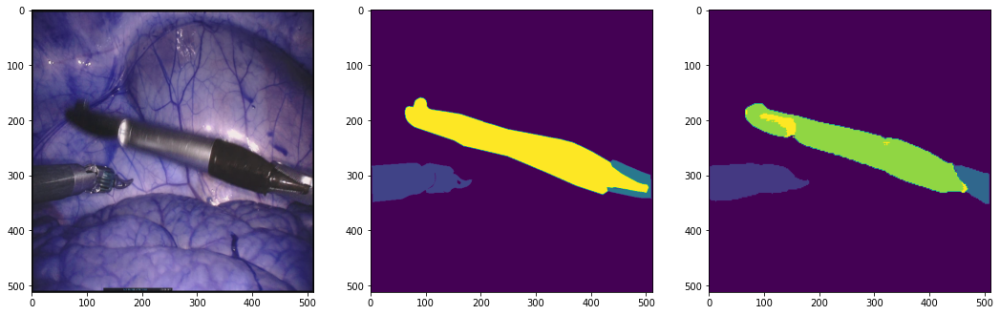

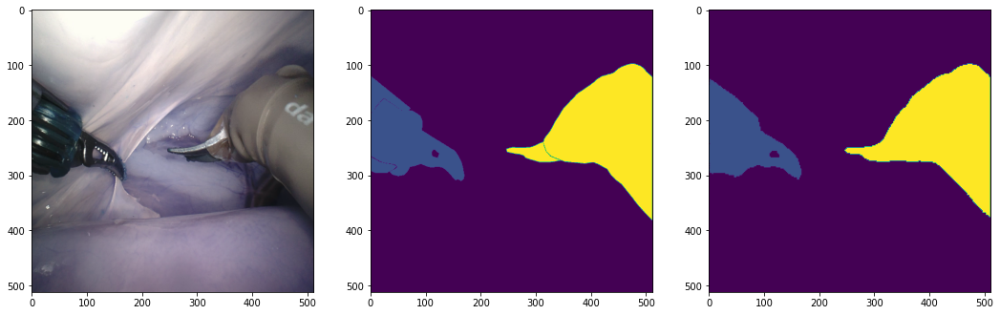

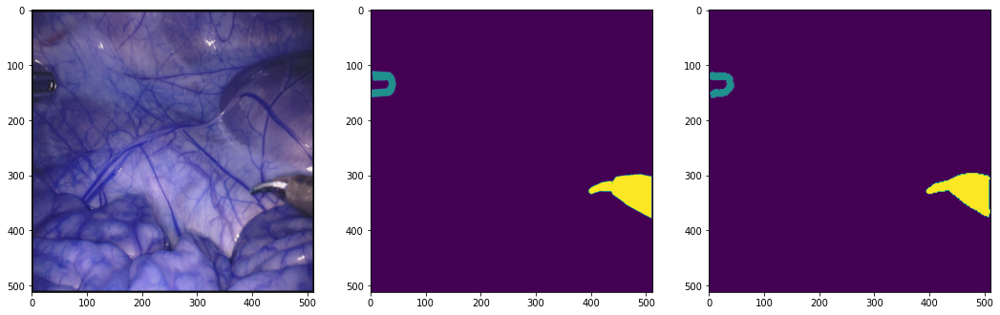

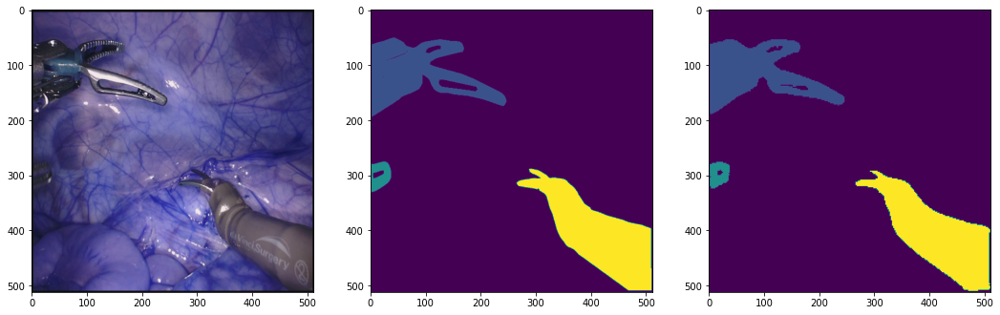

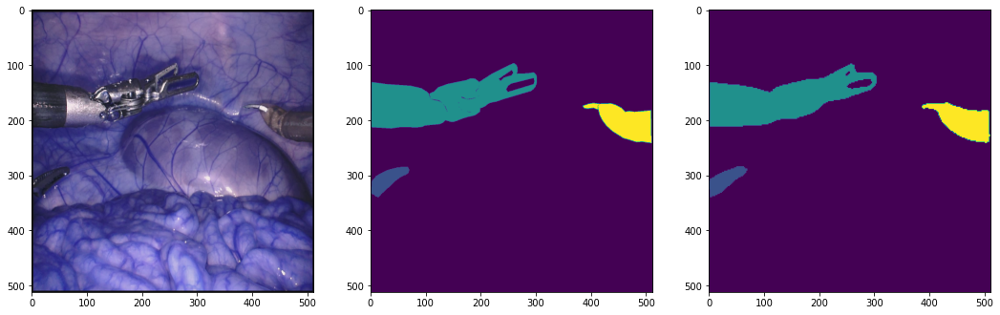

...

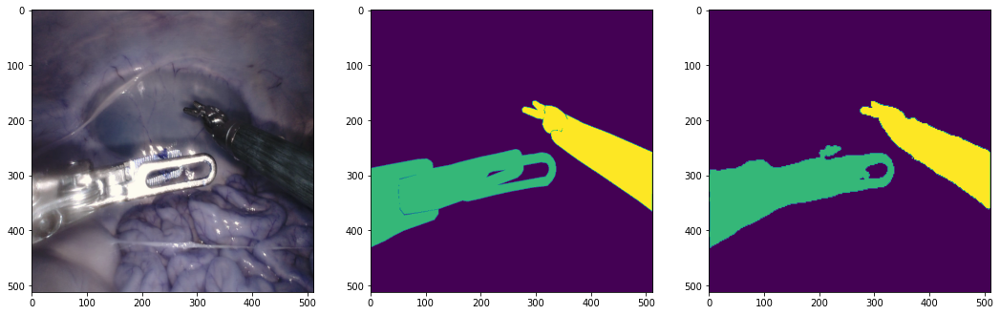

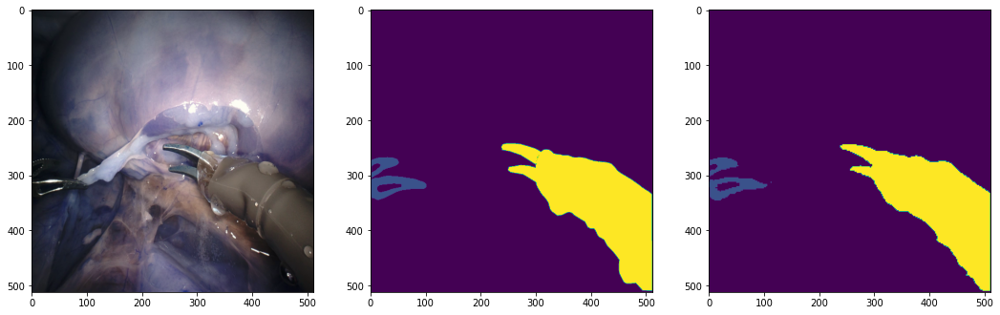

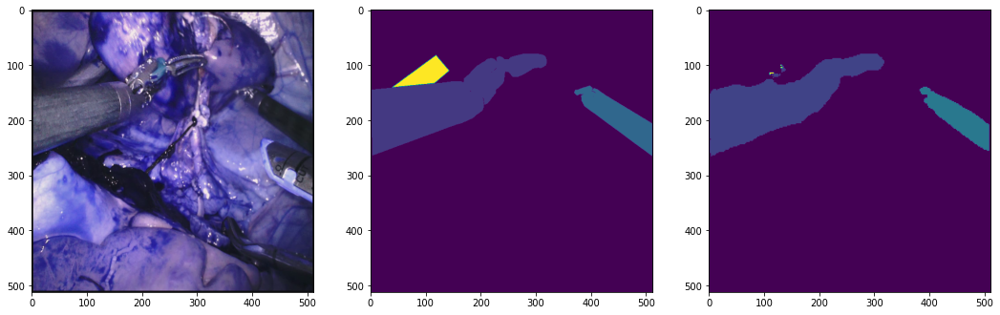

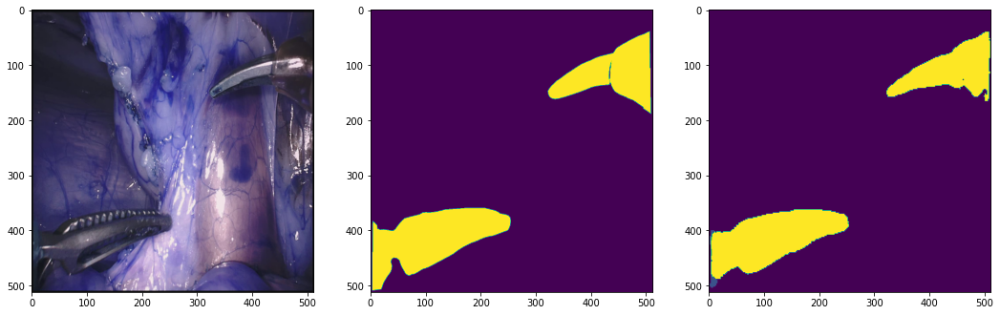

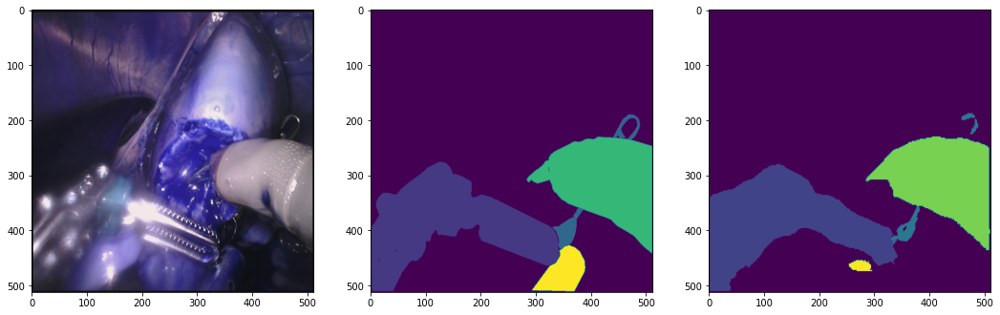

In [25]:
train_dataset = [load_images("train",train_filenames,batch_size,batch_number),load_segmasks("train",train_filenames,batch_size,batch_number)]
train_preds = seg_model.predict(train_dataset[0],batch_size = 1)
for i in range(batch_size):
    plt.figure(figsize = (18,12))
    plt.subplot(1,3,1).imshow(train_dataset[0][i])
    plt.subplot(1,3,2).imshow(np.argmax(train_dataset[1][i],axis = 2))
    plt.subplot(1,3,3).imshow(np.argmax(train_preds[i],axis = 2))
    plt.show()

In [26]:
from sklearn.metrics import accuracy_score, precision_score,recall_score, f1_score

In [29]:
train_accuracy = []
train_precision = []
train_recall = []
train_f1 = []
train_iou = []
train_miou = []
mean_train_dice = 0
for v in range(4):
    train_dataset = [load_images("train",train_filenames,batch_size,batch_number),load_segmasks("train",train_filenames,batch_size,batch_number)]
    train_preds = seg_model.predict(train_dataset[0],batch_size = 1)
    for j in range(len(train_preds)):
        train_accuracy.append(accuracy_score(np.argmax(train_preds[j],axis = 2).flatten(),np.argmax(train_dataset[1][j],axis = 2).flatten()))
        train_precision.append(precision_score(np.argmax(train_preds[j],axis = 2).flatten(),np.argmax(train_dataset[1][j],axis = 2).flatten(),average = 'macro',zero_division=0))
        train_recall.append(recall_score(np.argmax(train_preds[j],axis = 2).flatten(),np.argmax(train_dataset[1][j],axis = 2).flatten(),average = 'macro',zero_division=0))
        train_f1.append(f1_score(np.argmax(train_preds[j],axis = 2).flatten(),np.argmax(train_dataset[1][j],axis = 2).flatten(),average = 'macro',zero_division=0))
        
        train_iou.append(compute_iou(np.argmax(train_preds[j],axis = 2),np.argmax(train_dataset[1][j],axis = 2)))
        train_miou.append(class_wise_iou(train_preds[j],train_dataset[1][j]))
    mean_train_dice = (v*mean_train_dice + np.array(dice_coefficient(train_preds, train_dataset[1]).cpu()))/(v+1)
    gc.collect()

mean_train_acc = np.mean(np.array(np.nan_to_num(train_accuracy, nan=0)))
mean_train_prec = np.mean(np.array(np.nan_to_num(train_precision, nan=0)))
mean_train_rec = np.mean(np.array(np.nan_to_num(train_recall, nan=0)))
mean_train_f1 = np.mean(np.array(np.nan_to_num(train_f1, nan=0)))

mean_train_iou = np.mean(np.array(np.nan_to_num(train_iou, nan=0)))
mean_train_miou = np.mean(np.array(np.nan_to_num(train_miou, nan=0)))

32/32 [==============================] - 34s 1s/step
Instructions for updating:
Use tf.identity instead.
32/32 [==============================] - 34s 1s/step


In [30]:
print(f"Train Accuracy = {mean_train_acc}")
print(f"Train Precision = {mean_train_prec}")
print(f"Train Recall = {mean_train_rec}")
print(f"Train F1-Score = {mean_train_f1}")
print(f"Train IoU = {mean_train_iou}")
print(f"Train mIoU = {mean_train_miou}")
print(f"Train DICE = {mean_train_dice}")

Train Accuracy = 0.980005145072937
Train Precision = 0.5647971770652747
Train Recall = 0.5782216286916295
Train F1-Score = 0.5695424240538587
Train IoU = 0.25117355585098267
Train mIoU = 0.36017051339149475
Train DICE = 0.6716904044151306


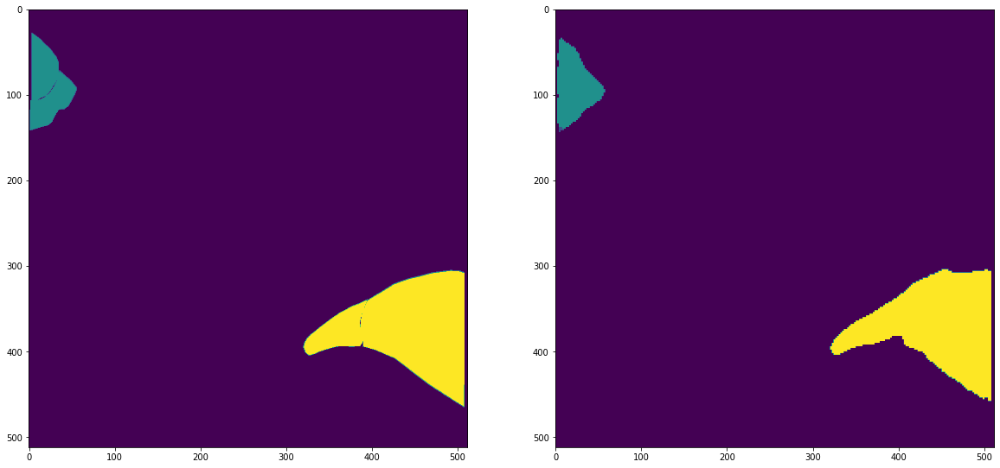

In [33]:
sample = 9
plt.figure(figsize = (20,12))
plt.subplot(1,2,1).imshow(np.argmax(train_dataset[1][sample],axis = 2))
plt.subplot(1,2,2).imshow(np.argmax(train_preds[sample],axis = 2))
plt.show()

InvalidArgumentError: {{function_node __wrapped__StridedSlice_device_/job:localhost/replica:0/task:0/device:GPU:0}} Index out of range using input dim 0; input has only 0 dims [Op:StridedSlice] name: strided_slice/

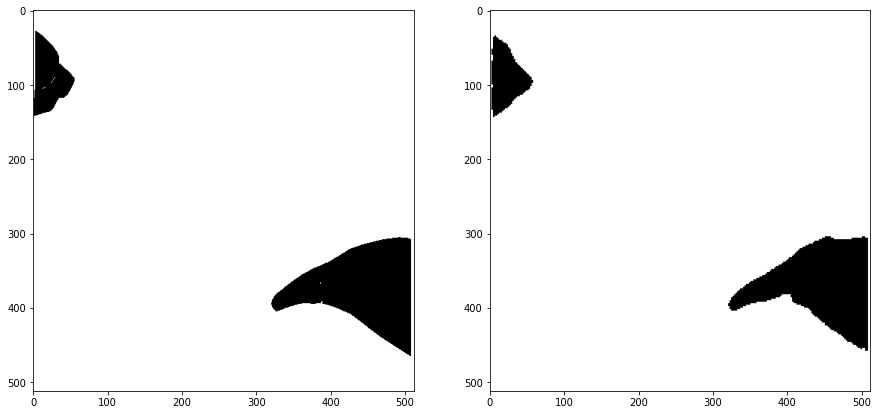

In [36]:
for i in range(num_classes):
    plt.figure(figsize = (15,8))
    plt.subplot(1,2,1).imshow(np.argmax(train_dataset[1][sample],axis = 2) == i,cmap = 'gray')
    plt.subplot(1,2,2).imshow(np.argmax(train_preds[sample],axis = 2) == i,cmap = 'gray')
    plt.suptitle(train_miou[sample][i])
    plt.show()

In [25]:
train_iou = []
train_miou = []
mean_train_dice = 0
for v in range(4):
    train_dataset = [load_images("train",train_filenames,batch_size,batch_number),load_segmasks("train",train_filenames,batch_size,batch_number)]
    train_preds = seg_model.predict(train_dataset[0],batch_size = 1)
    for j in range(len(train_preds)):
        train_iou.append(compute_iou(np.argmax(train_preds[j],axis = 2),np.argmax(train_dataset[1][j],axis = 2)))
        train_miou.append(class_wise_iou(train_preds[j],train_dataset[1][j]))
    mean_train_dice = (v*mean_train_dice + np.array(dice_coefficient(train_preds, train_dataset[1]).cpu()))/(v+1)
    gc.collect()

mean_train_iou = np.mean(np.array(np.nan_to_num(train_iou, nan=0)))
mean_train_miou = np.mean(np.array(np.nan_to_num(train_miou, nan=0)))
print(f"Val IoU = {mean_train_iou}")
print(f"Val mIoU = {mean_train_miou}")
print(f"Val DICE = {mean_train_dice}")

64/64 [==============================] - 6s 88ms/step


C:\Users\ARRUNP~1\AppData\Local\Temp/ipykernel_11940/2714150921.py:9: RuntimeWarning: invalid value encountered in long_scalars
  iou = np.sum(intersection) / np.sum(union)


64/64 [==============================] - 5s 82ms/step
Val IoU = 0.8519196961634855
Val mIoU = 0.12526388847915168
Val DICE = 0.6737698316574097


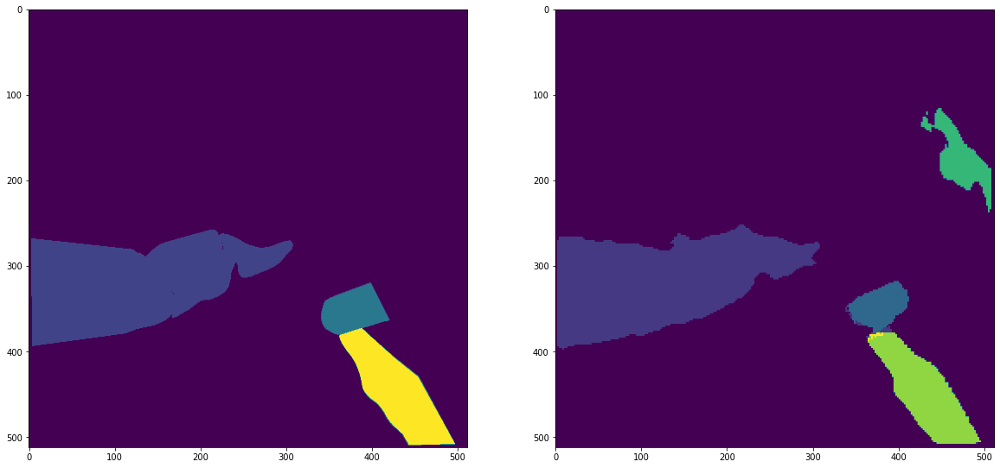

In [35]:
sample = 1
plt.figure(figsize = (20,12))
plt.subplot(1,2,1).imshow(np.argmax(train_dataset[1][sample],axis = 2))
plt.subplot(1,2,2).imshow(np.argmax(train_preds[sample],axis = 2))
plt.show()

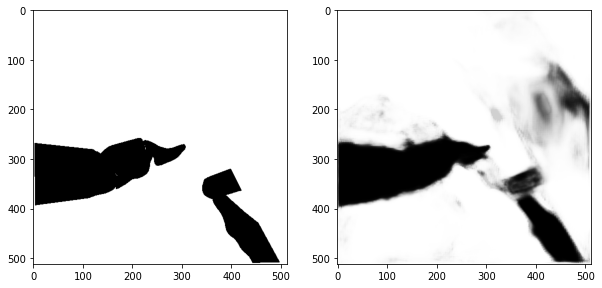

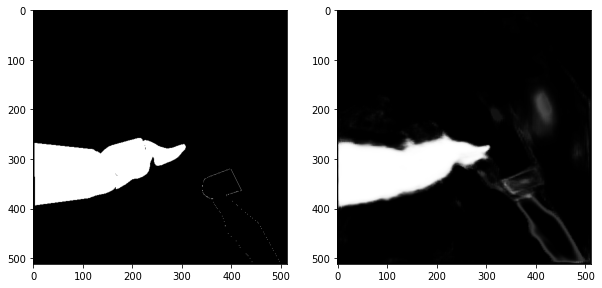

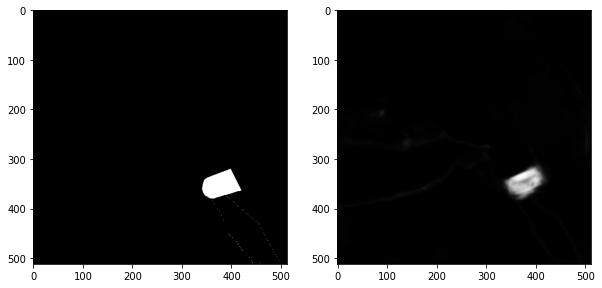

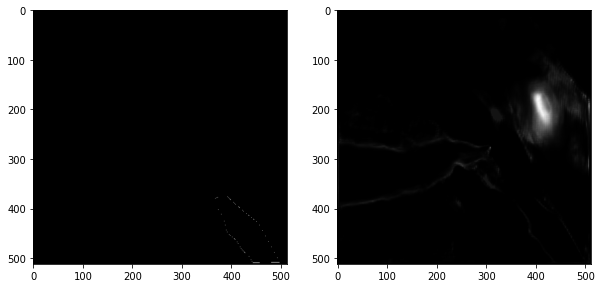

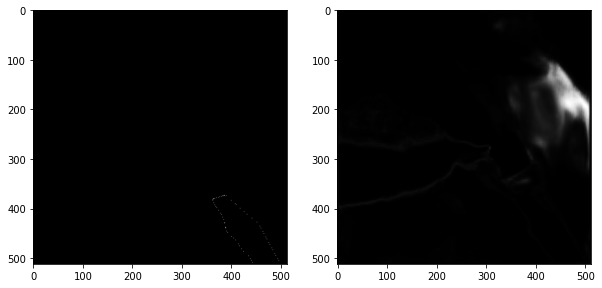

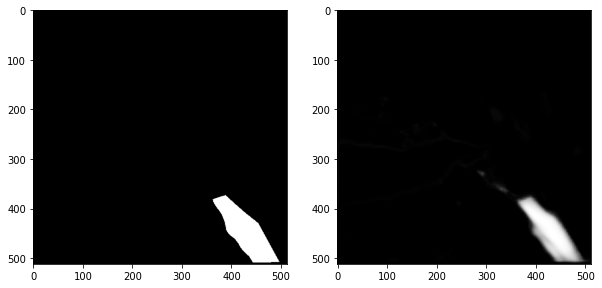

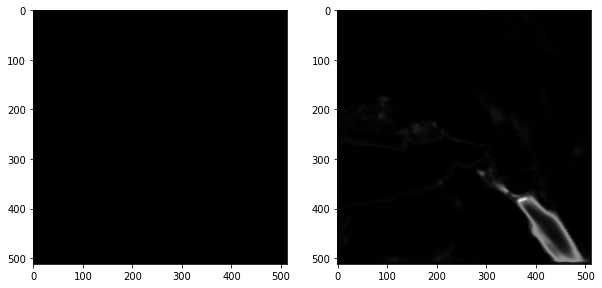

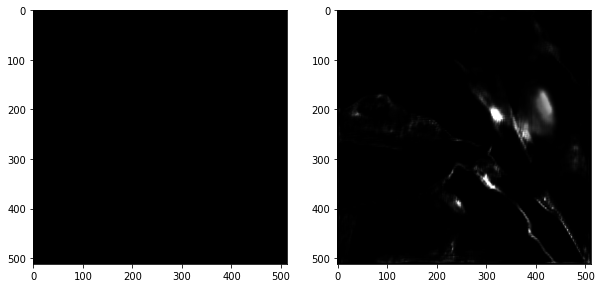

In [36]:
sample = 1
for i in range(num_classes):
    plt.figure(figsize = (10,8))
    plt.subplot(1,2,1).imshow(train_dataset[1][sample][:,:,i],cmap = 'gray')
    plt.subplot(1,2,2).imshow(train_preds[sample][:,:,i],cmap = 'gray')
    plt.show()

## Prediction on val batch

64/64 [==============================] - 6s 91ms/step


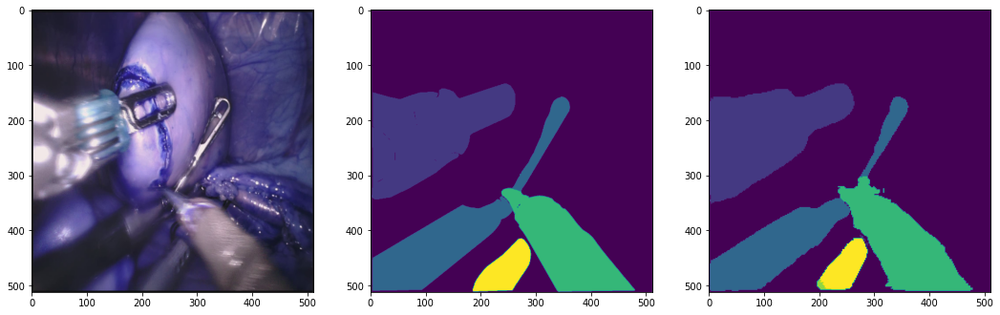

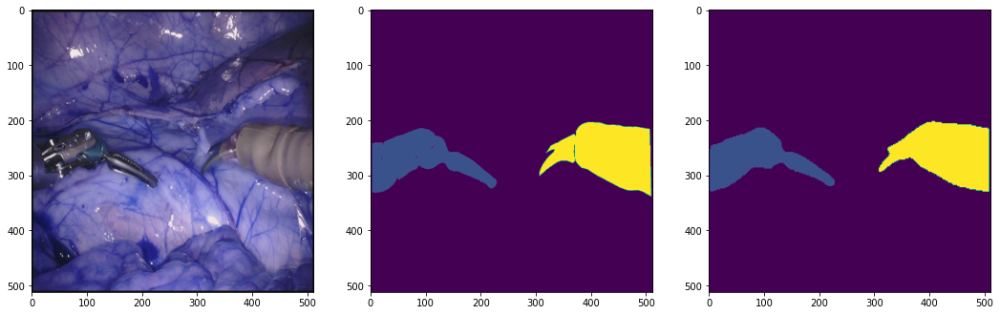

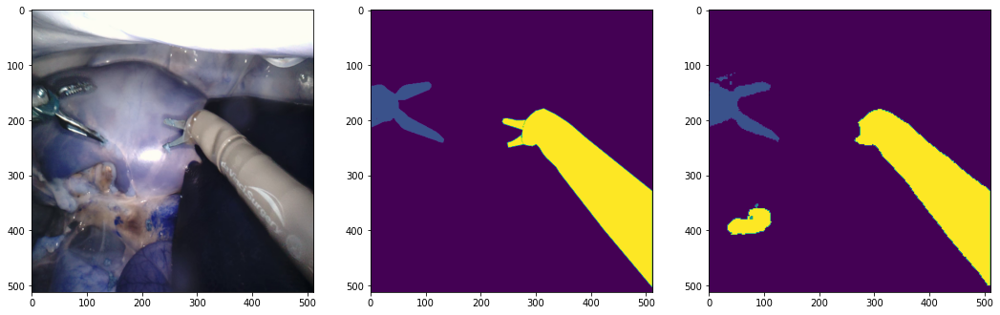

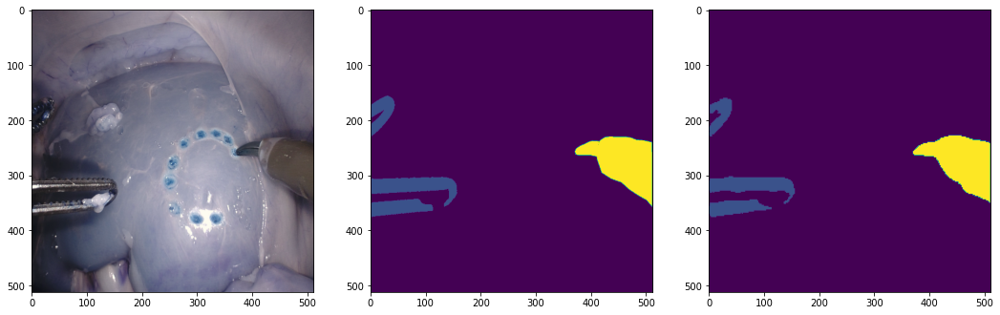

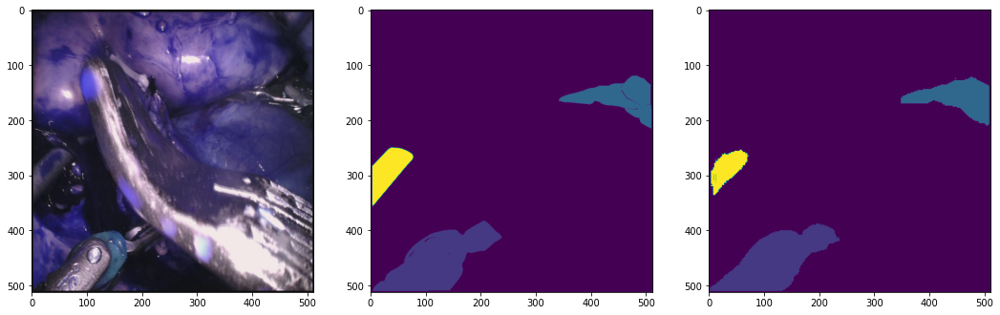

...

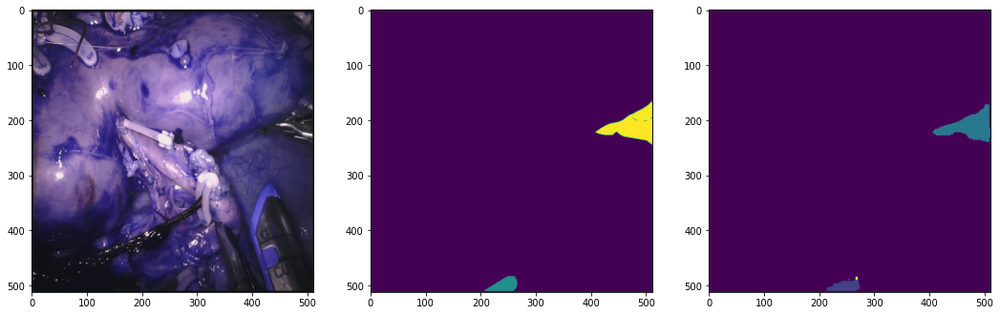

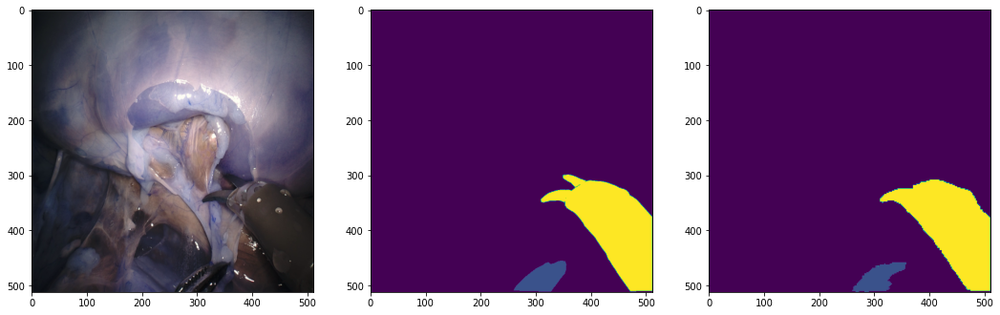

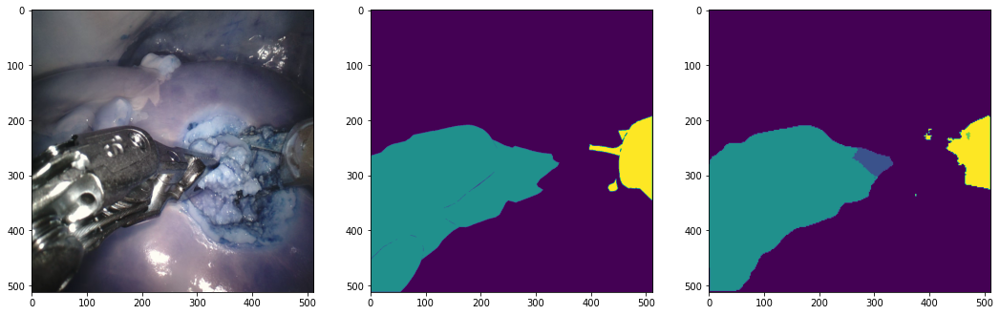

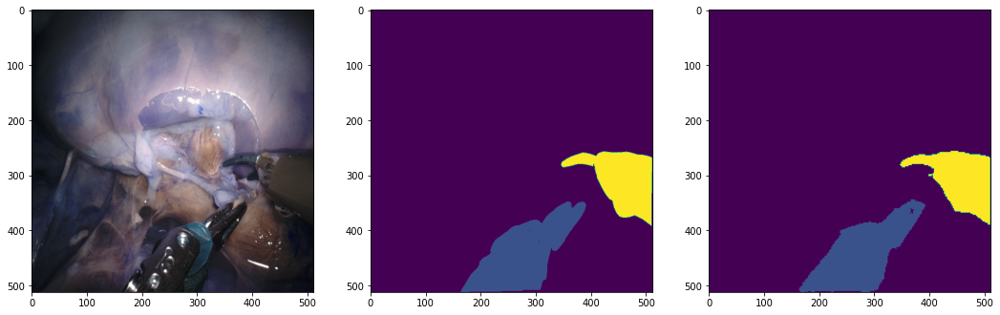

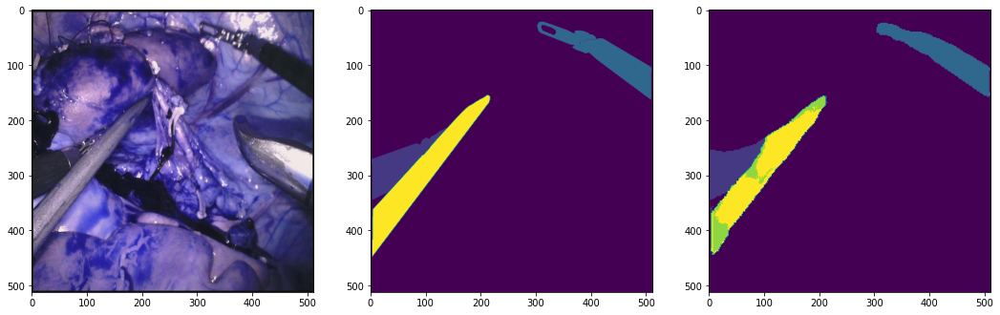

In [37]:
batch_number = 1
batch_size = 64
val_dataset = [load_images("train",val_filenames,batch_size,batch_number),load_segmasks("train",val_filenames,batch_size,batch_number)]
val_preds = seg_model.predict(val_dataset[0],batch_size = 1)
for i in range(batch_size):
    plt.figure(figsize = (18,12))
    plt.subplot(1,3,1).imshow(val_dataset[0][i])
    plt.subplot(1,3,2).imshow(np.argmax(val_dataset[1][i],axis = 2))
    plt.subplot(1,3,3).imshow(np.argmax(val_preds[i],axis = 2))
    plt.show()

In [38]:
mean_test_iou = 0
mean_test_dice = 0
test_iou = []
test_miou = []
for i in range(max_batch_number):
    test_dataset = [load_images("val_new",test_filenames,batch_size,i),load_segmasks("val_new",test_filenames,batch_size,i)]
    test_preds = seg_model.predict(test_dataset[0],batch_size = 1)
    
    for j in range(len(test_preds)):
        plt.figure(figsize = (18,12))
        plt.subplot(1,3,1).imshow(test_dataset[0][i])
        plt.subplot(1,3,2).imshow(np.argmax(test_dataset[1][i],axis = 2))
        plt.subplot(1,3,3).imshow(np.argmax(test_preds[i],axis = 2))
        plt.show()
        
        test_iou.append(compute_iou(np.argmax(test_preds[j],axis = 2),np.argmax(test_dataset[1][j],axis = 2)))
        test_miou.append(class_wise_iou(test_preds[j],test_dataset[1][j]))
    
    mean_test_iou = (i*mean_test_iou + np.mean(np.array(test_iou)))/(i+1)
    mean_test_miou = (i*mean_test_miou + np.mean(np.array(test_iou)))/(i+1)
    mean_test_dice = (i*mean_test_dice + np.mean(np.array(dice_coefficient(test_preds, test_dataset[1]).cpu())))/(i+1)

print(f"Test IoU = {mean_test_iou}")
print(f"Test IoU = {mean_test_miou}")
print(f"Test DICE = {mean_test_dice}")

NameError: name 'test_filenames' is not defined

## Prediction on test batch

In [26]:
total_test_images = len(os.listdir(os.path.join(val_dir,"images")))
start_batch_number = 1
batch_size = 64
max_batch_number = total_test_images//batch_size
test_filenames = os.listdir(os.path.join(val_dir,'images'))

In [39]:
mean_test_iou = 0
mean_test_dice = 0
test_iou = []
test_miou = []
for i in range(max_batch_number):
    test_dataset = [load_images("val_new",val_filenames,batch_size,i),load_segmasks("val_new",val_filenames,batch_size,i)]
    test_preds = seg_model.predict(test_dataset[0],batch_size = 1)
    
    for j in range(len(test_preds)):
        plt.figure(figsize = (18,12))
        plt.subplot(1,3,1).imshow(test_dataset[0][i])
        plt.subplot(1,3,2).imshow(np.argmax(test_dataset[1][i],axis = 2))
        plt.subplot(1,3,3).imshow(np.argmax(test_preds[i],axis = 2))
        plt.show()
        
        test_iou.append(compute_iou(np.argmax(test_preds[j],axis = 2),np.argmax(test_dataset[1][j],axis = 2)))
        test_miou.append(class_wise_iou(test_preds[j],test_dataset[1][j]))
    
    mean_test_iou = (i*mean_test_iou + np.mean(np.array(test_iou)))/(i+1)
    mean_test_miou = (i*mean_test_miou + np.mean(np.array(test_iou)))/(i+1)
    mean_test_dice = (i*mean_test_dice + np.mean(np.array(dice_coefficient(test_preds, test_dataset[1]).cpu())))/(i+1)

error: OpenCV(4.8.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'cv::resize'


In [31]:
print(f"Test IoU = {mean_test_iou}")
print(f"Test DICE = {mean_test_dice}")

Test IoU = 0.8637341204491146
Test DICE = 0.6585207581520081
